In [1]:
import Pkg; Pkg.activate("../")

In [7]:
include("../src/Utils.jl")
#include("../src/TI-Utils.jl")
using Serialization, DelimitedFiles, Plots
using StatsPlots
using UMAP

In [8]:
Random.seed!(123)
n = 1_200 # for ight now n needs to be divisble by 3
A_cycle, A_type = 10, 10 # 10, 10 and 10, 4
# seeds = [555, 145, 275, 435, 487]
# seed = seeds[1]
X, cycle_labs, type_labs, t = simple_sim(n, A_cycle, A_type, σ_cycle=0.1, σ_type=0.3, rng=123, sampling=:normal, use_seed=true); # arguments: simple_sim(n, A_circle, A_blob, K_cycle=3, rng=123, σ_cycle=0.1, σ_type=0.3, scale_vars=false)
#X = hcat(X, rand(Normal(0, 5), n, 5000)) # noise = 8; lda at n=5_0000, separates blobs, numdim=5000
X = hcat(X, rand(Normal(0, 5), n, 100));

In [9]:
T_bc = bclust_var(X, cycle_labs)
println(T_bc)
T = total_var(X)

194.93445809046983


25182.8271562717

In [66]:
T_bt = bclust_var(X, type_labs)

272.38326130394717

In [5]:
pcs = collect(getPCs(collect(X'), true)');

p_1 = bclust_var(pcs[:,1], cycle_labs)
p_2 = bclust_var(pcs[:,2], cycle_labs)
println("pb1: $(get_variances(pcs)[1]/sum(get_variances(pcs))); pb2:$(get_variances(pcs)[2]/sum(get_variances(pcs))); pb3:$(get_variances(pcs)[3]/sum(get_variances(pcs)))")

pb1: 0.005663238560131278; pb2:0.004140294063060596; pb3:0.0039715734699540305


In [10]:
Y, R = cluster_projection(collect(X'),cycle_labs, false, :mean);
our_1 = bclust_var(collect(Y[1,:]), cycle_labs)
our_2 = bclust_var(collect(Y[2,:]), cycle_labs)
println(our_1/ T_bc)
println(our_2 / T_bc)

0.44756266297074143
0.4058221339383959


In [11]:
mlda, Y_lda = mLDA(collect(X'), cycle_labs, true);
bclust_var(collect(Y_lda[1:2,:]'), cycle_labs)

0.02491884637420827

In [ ]:
cor([1,1,1,2,2,2], [])

In [39]:
Y_umap = umap(collect(X)')

2×1200 Matrix{Float64}:
 -0.594299   1.19637    1.25732   …   0.719566  -0.137621   0.502842
 -0.667428  -0.466495  -0.789076     -2.53432    3.33639   -1.79184

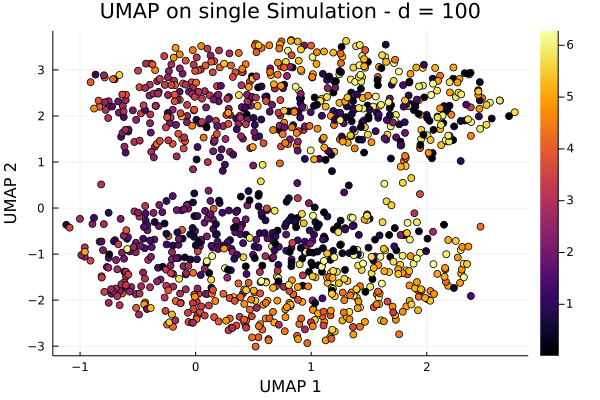

In [40]:
scatter(Y_umap[1,:], Y_umap[2,:], marker_z = t, colorbar=true, leg=:false, xlab="UMAP 1", ylab="UMAP 2", title="UMAP on single Simulation - d = 100")

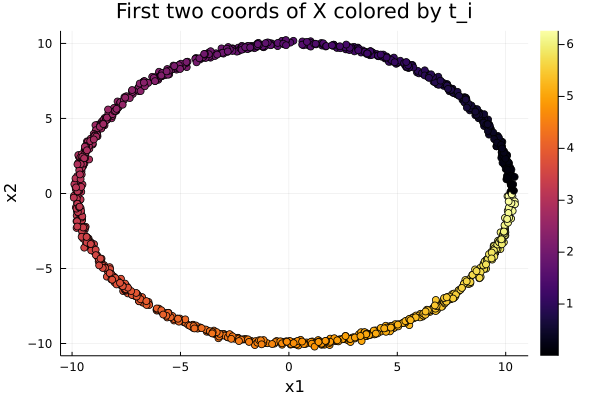

In [70]:
scatter(X[:, 1], X[:,2], marker_z = t, colorbar=true, leg=:false, xlab="x1", ylab="x2", title="First two coords of X colored by t_i")

In [196]:
scatter(X[:, 1], X[:,2], X[:,3], marker_z = t, colorbar=true, leg=:false, title="Two Cell types with Cell Cycle", axis=nothing, border=:none, 
shape=shapes, markersize=15)

In [108]:
scatter(pcs[:,1], pcs[:,2], marker_z = t, colorbar=true, leg=false, title="PCA colored by Cell Cycle Pseudotime", xlab="PC 1", ylab="PC 2")#, dpi=300)
#savefig("figures/example-sim-pca")

In [112]:
scatter(pcs[:,1], pcs[:,2], c=type_labs, title="PCA colored by Cell Type", xlab="PC 1", ylab="PC 2", legend=true)#, dpi=300)

In [125]:
d = Dict(-10 => "Cell Type 1", 10 => "Cell Type 2")
pcs2 = getPCs(collect(X'));
addlabels!(pcs2, cycle_labs, type_labs);
pcs2[!,:cell_type] .= [d[c] for c in pcs2[!,:cell_type]];

In [194]:
@df pcs2 scatter(:PC_1, :PC_2, marker_z=t, legend=false, xlabel="PC 1", ylabel="PC 2", title="PCA -- Colored by Cell Cycle Pseudotime",
shape=shapes, markersize=15, xguidefontsize=15, yguidefontsize=15)

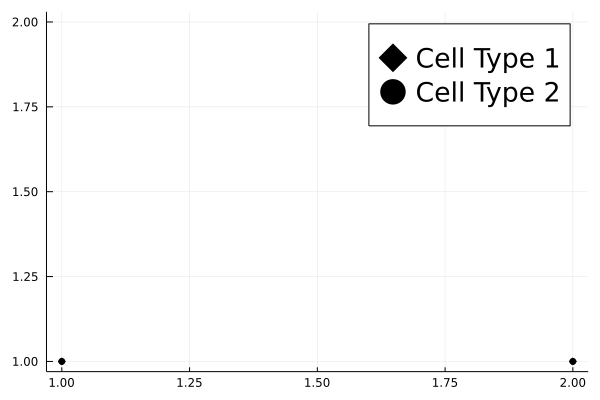

In [187]:
scatter(1:2,1:1.5, legend=true, shape=:diamond, label="Cell Type 1", c=:black)
scatter!(1:2,1:1.5,shape=:circle, label="Cell Type 2", c=:black, legendfont=font(18))

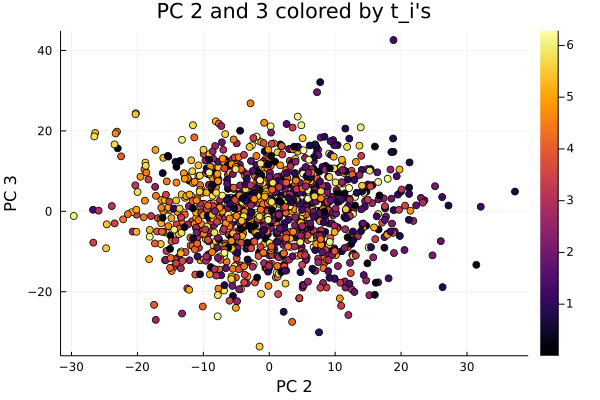

In [64]:
scatter(pcs[:,2], pcs[:,3], marker_z = t, colorbar=true, leg=false, title="PC 2 and 3 colored by t_i\'s", xlab="PC 2", ylab="PC 3")

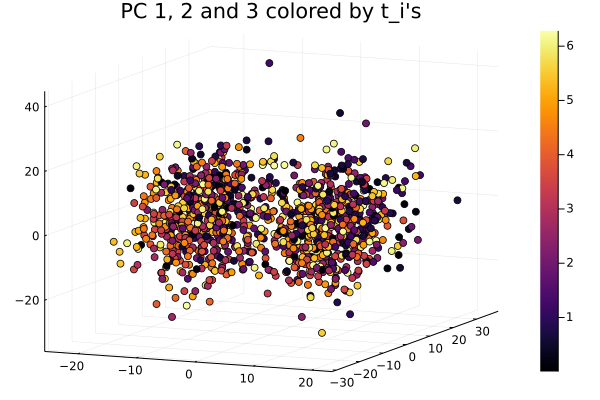

In [65]:
scatter(pcs[:,1], pcs[:,2], pcs[:,3], marker_z = t, colorbar=true, leg=false, title="PC 1, 2 and 3 colored by t_i\'s")

In [13]:
scatter(pcs[:,1], pcs[:,2], marker_z = t, colorbar=true, leg=false, title="PC 1, 2 and 3 colored by t_i\'s", shape=shapes)

LoadError: UndefVarError: shapes not defined

In [268]:
d = Dict(-10 => "Cell Type 1", 10 => "Cell Type 2")
d2 = Dict(-10 => :diamond, 10 => :circle)
Y2 = deepcopy(Y)
df_Y = DataFrame(collect(Y2'), :auto)
addlabels!(df_Y, cycle_labs, type_labs)
shapes = [d2[c] for c in df_Y[!,:cell_type]]
df_Y[!,:cell_type] .= [d[c] for c in df_Y[!,:cell_type]];

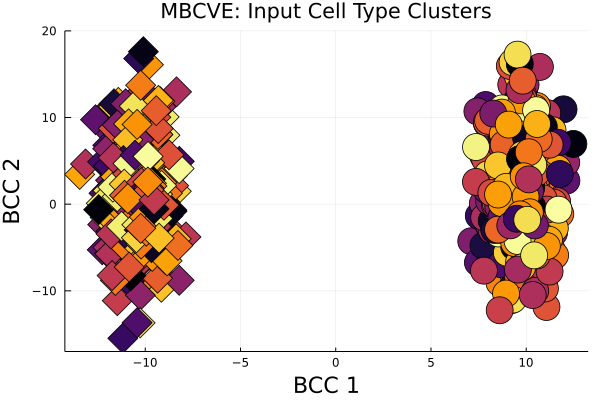

In [248]:
#scatter(Y[1,:], Y[2,:], c=type_labs, legend=false, xlabel="BC 1", ylabel="BC 2", title="MCBVE with Cell Type Clusters")
@df df_Y scatter(:x1, :x2, marker_z=t, legend=false, xlabel="BCC 1", ylabel="BCC 2", title="MBCVE: Input Cell Type Clusters",
shape=shapes, markersize=15, xguidefontsize=15, yguidefontsize=15, ylim=(-17, 20))

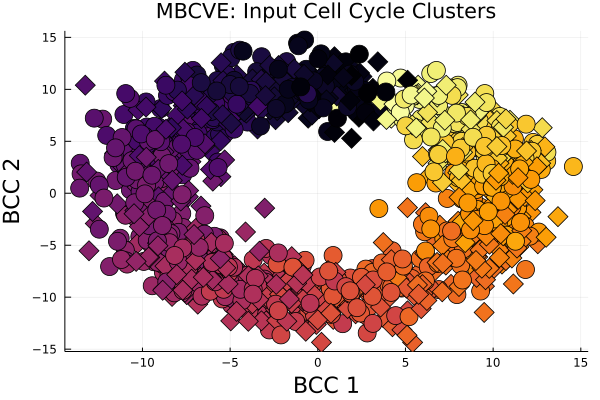

In [210]:
@df df_Y scatter(:x1, :x2, marker_z=t, legend=false, xlabel="BCC 1", ylabel="BCC 2", title="MBCVE: Input Cell Cycle Clusters",
shape=shapes, markersize=10, xguidefontsize=15, yguidefontsize=15)

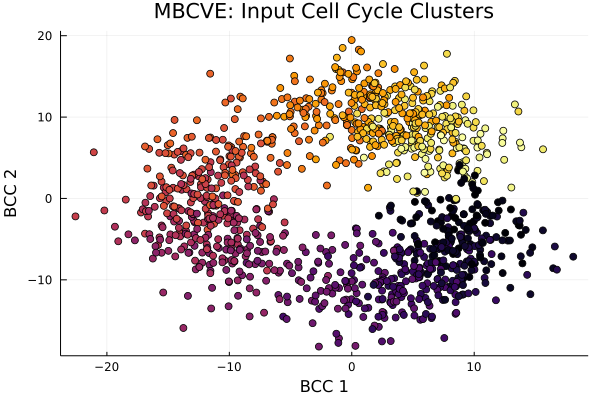

In [269]:
@df df_Y scatter(:x1, :x2, marker_z=t, legend=false, xlabel="BCC 1", ylabel="BCC 2", title="MBCVE: Input Cell Cycle Clusters")

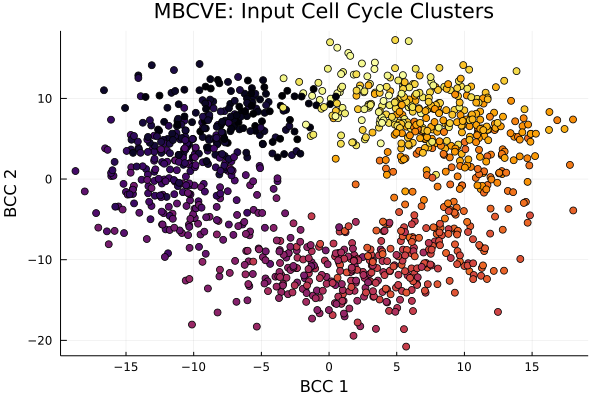

In [273]:
Yw = MBCVE(collect(X'), cycle_labs, weighted=true, as_df=true)
@df Yw scatter(:PC_1, :PC_2, marker_z=t, legend=false, xlabel="BCC 1", ylabel="BCC 2", title="MBCVE: Input Cell Cycle Clusters")

In [241]:
@df df_Y scatter(:x1, :x2, marker_z=t, legend=false, colorbar=true, xlabel="BCC 1", ylabel="BCC 2", 
title="MBCVE colored by t_i's", xguidefontsize=15, yguidefontsize=15, dpi=300)
savefig("figures/example-sim-ours")

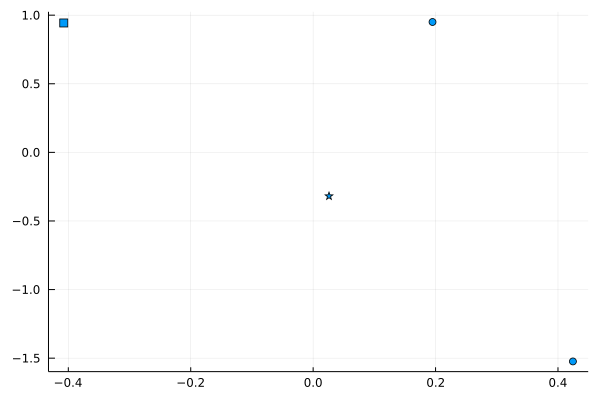

In [152]:
scatter(randn(4), randn(4), shape=[:circle, :circle, :rect, :star], legend=false)

In [260]:
scatter(Y_lda[1,:], Y_lda[2,:], marker_z=t, colorbar=true, leg=false, title="mLDA colored by t_i\'s", xlabel="mLDA 1", ylabel="mLDA 2")
savefig("figures/lda-example")

In [67]:
cls = ones(n) # cluster labels for slingshot; assume that each points belongs to same cluster.
s_true = slingshot_ordering(collect(X[:,1:2]'), cycle_labs)
num_pcs = 3
s_pc = slingshot_ordering(collect(pcs[:,1:3]'), cycle_labs)
s_ours = slingshot_ordering(Y[1:2,:], cycle_labs)
s_lda = slingshot_ordering(Y_lda[1:2,:], cycle_labs);
ss = [s_true, s_pc, s_ours, s_lda]

┌ Warning: RCall.jl: Using full covariance matrix
└ @ RCall /Users/alexanderstrzalkowski/.julia/packages/RCall/3mHXJ/src/io.jl:160
┌ Warning: RCall.jl: Using full covariance matrix
└ @ RCall /Users/alexanderstrzalkowski/.julia/packages/RCall/3mHXJ/src/io.jl:160
┌ Warning: RCall.jl: Using full covariance matrix
└ @ RCall /Users/alexanderstrzalkowski/.julia/packages/RCall/3mHXJ/src/io.jl:160
┌ Warning: RCall.jl: Using full covariance matrix
└ @ RCall /Users/alexanderstrzalkowski/.julia/packages/RCall/3mHXJ/src/io.jl:160


4-element Vector{Vector{Float64}}:
 [0.0, 23.910386261311928, 7.068980961182698, 29.905772230806917, 35.62369503117647, 43.03210681756458, 53.26979151107857, 11.903553467080377, 37.725889660400775, 44.82164146432446  …  40.000313316424915, 25.866263073773972, 17.29151139403756, 17.283008561048273, 4.782386081361618, 41.81731222446099, 9.972180600035921, 44.831314497201284, 17.22951047917661, 11.888172833086655]
 [103.66693342682046, 69.16713433416729, 74.7950310540436, 105.86331652270461, 58.910518372888596, 81.6860967430202, 45.68843919228973, 102.25037661654171, 82.20546333222309, 82.07604410297854  …  61.03501520975932, 83.27224501776381, 29.513663050122588, 39.610125280534376, 71.24180809262218, 63.19985882218586, 26.017258569335286, 45.913014315492305, 95.34735362400937, 96.75760802253882]
 [9.664366507072765, 35.12723416583735, 16.89705632692986, 36.28052134606691, 55.375399341478506, 54.65904969513988, 0.6959331101003859, 13.084091181610479, 51.609049923714934, 55.40894833773326

In [68]:
for s in ss
    println(fix_angle(s, t)[1])
end

0.9902790135783868
0.1262463555400729
0.8275550026287203
0.7211361698195861


In [177]:
using DataFrames

0.9887900735336086


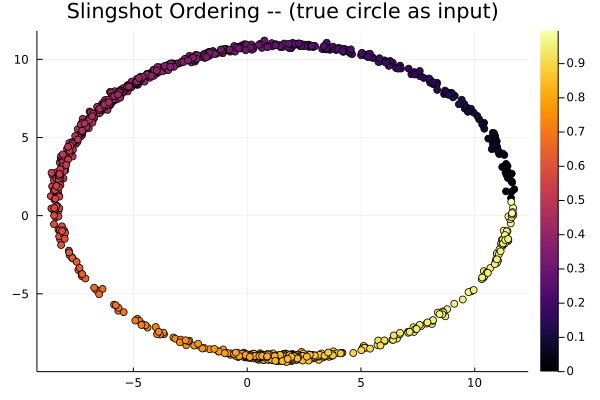

In [100]:
tit = "Slingshot Ordering -- (true circle as input)"
s_true_adjust = fix_angle(s_true, t)[2] # 0.32 works
println(corkendall(s_true_adjust, t))
scatter(X[:, 1], X[:,2], marker_z =s_true_adjust, colorbar=true, leg=:false, title=tit)

0.38628144203735626


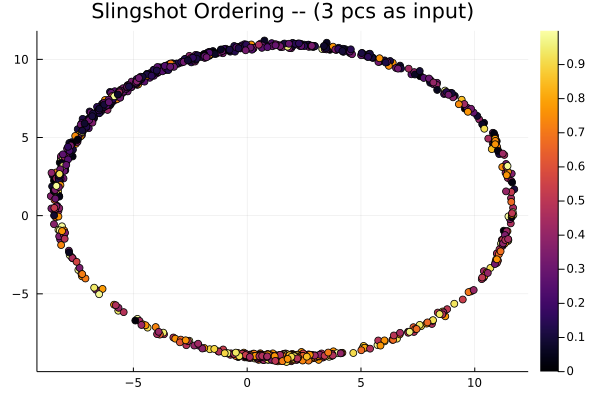

In [101]:
tit = "Slingshot Ordering -- ($(num_pcs) pcs as input)"
s_pc_adjust = fix_angle(s_pc, t)[2]
println(corkendall(s_pc_adjust, t))
scatter(X[:,1], X[:,2], marker_z=s_pc_adjust, colorbar=true, leg=:false, title=tit)

0.7497150326787423


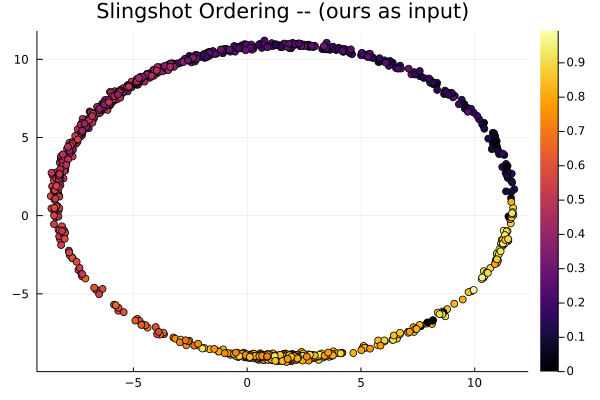

In [102]:
tit = "Slingshot Ordering -- (ours as input)"
s_ours_adjust = fix_angle(s_ours, t)[2] # 0.3 works
println(corkendall(s_ours_adjust, t))
scatter(X[:,1], X[:,2], marker_z=s_ours_adjust, colorbar=true, leg=:false, title=tit)

0.7168846152552852


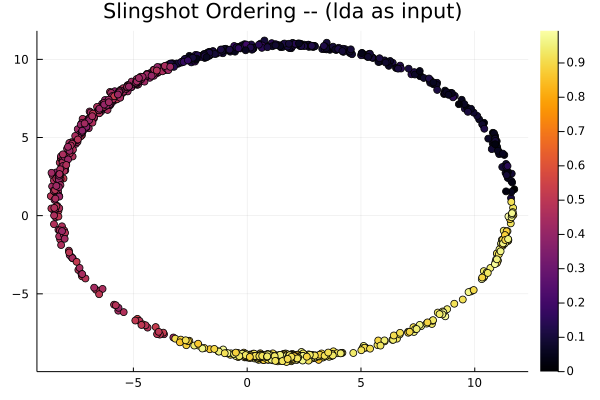

In [103]:
tit = "Slingshot Ordering -- (lda as input)"
s_lda_adjust = fix_angle(s_lda, t)[2]
println(corkendall(s_lda_adjust, t))
scatter(X[:,1], X[:,2], marker_z=s_lda_adjust, colorbar=true, leg=:false, title=tit)

In [75]:
scatter(Y[1,:], Y[2,:], marker_z=t, colorbar=true, leg=:false, title="Ours colored by t_i\'s", xlabel="Ours 1", ylabel="Ours 2", dpi=300)
savefig("figures/example-sim-ours")

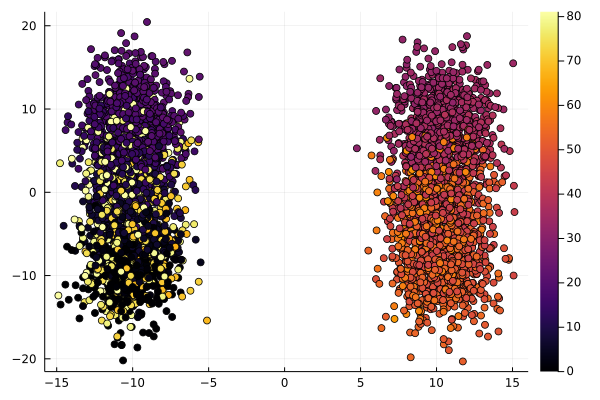

In [19]:
scatter(pcs[:, 1], pcs[:,2], marker_z = slingshot_pc_circle, colorbar=true, leg=:false)

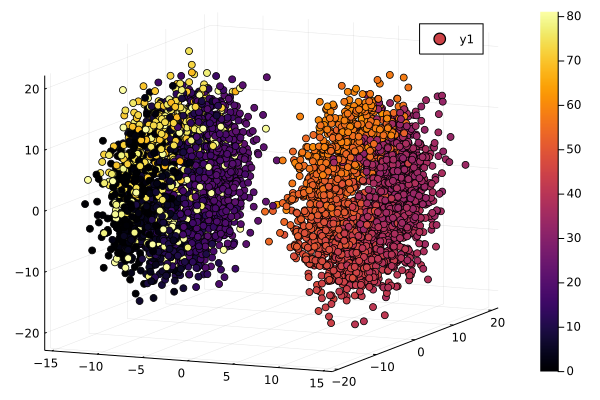

In [17]:
scatter(pcs[:,1], pcs[:,2], pcs[:,3], marker_z=slingshot_pc_circle, colorbar=true)

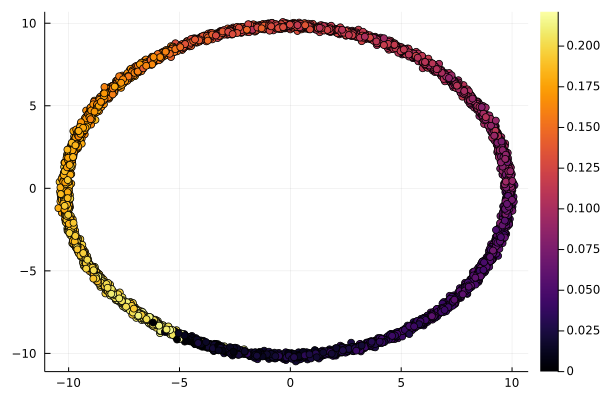

In [20]:
scatter(X[:,1], X[:,2], marker_z=slingshot_lda_circle, colorbar=true, leg=:false)

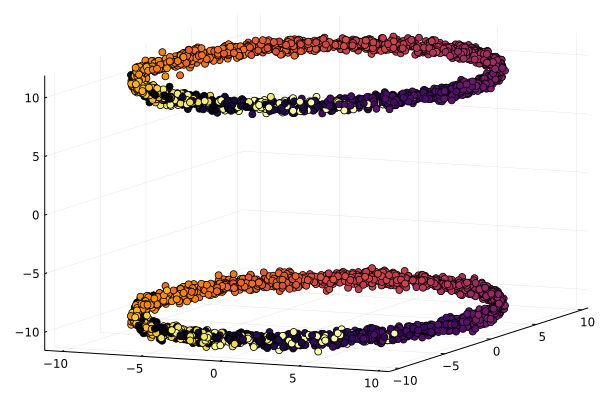

In [23]:
scatter(X[:,1], X[:,2], X[:,3], marker_z=slingshot_ours_circle, leg=false)

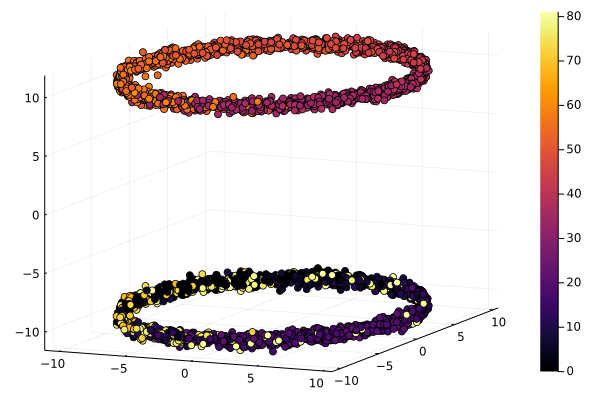

In [24]:
scatter(X[:,1], X[:,2], X[:,3], marker_z=slingshot_pc_circle, colorbar=true, leg=:false)

In [25]:
corkendall(slingshot_true_circle, t)

0.09856475980787219

In [26]:
corkendall(slingshot_pc_circle, t)

0.05365013980743671

In [27]:
corkendall(slingshot_ours_circle, t)

0.16055287673550553

In [28]:
corkendall(slingshot_lda_circle, t)

0.027221451975055752

In [29]:
newts = mod.(t, 2π);

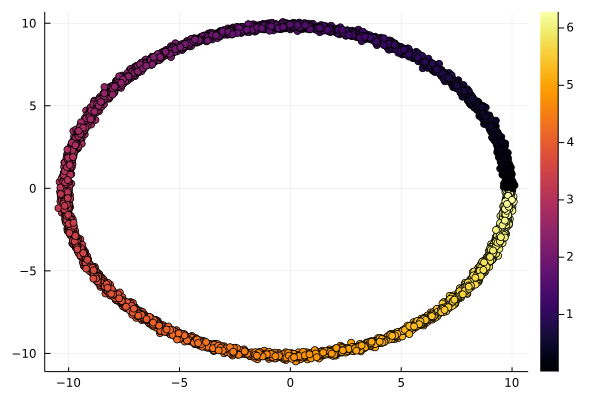

In [30]:
scatter(X[:, 1], X[:,2], marker_z = newts, colorbar=true, leg=:false)

In [35]:
ourts = slingshot_ours_circle / maximum(slingshot_ours_circle)
newours = mod.(ourts .- 0.3, 1.0);

In [ ]:
function adjust_angle(ts, a)
    ts_normed = ts / maximum(ts)
    return mod.(ts_normed .- a, 1.0)
end

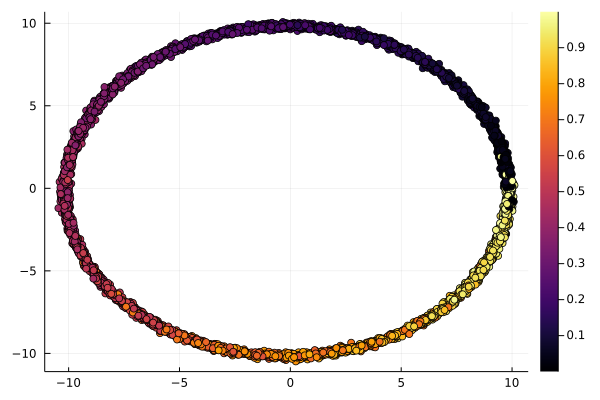

In [36]:
scatter(X[:, 1], X[:,2], marker_z = newours, colorbar=true, leg=:false)

In [37]:
corkendall(t, newours)

0.8607477652066894

In [235]:
using ManifoldLearning

┌ Info: Precompiling ManifoldLearning [06eb3307-b2af-5a2a-abea-d33192699d32]
└ @ Base loading.jl:1317


In [251]:
    @time M = fit(LEM, collect(pcs[:,1:3]'), maxoutdim=2)
    @time R = ManifoldLearning.transform(M) 

  0.703630 seconds (735.02 k allocations: 180.628 MiB)
  0.000005 seconds


2×1200 transpose(::Matrix{Float64}) with eltype Float64:
 0.00721142  0.0075242    0.00724549  …  -0.00790568   0.00736221
 0.0039634   0.000312513  0.00436594     -0.000720393  0.00417598

In [30]:
Y_lda

3×1200 Matrix{Float64}:
  0.169973    -0.228609   -0.211276     …  -0.240712   -0.224456
  0.154783     0.0192314   0.000135231      0.0215929  -0.0252763
 -0.00299927   0.0167559   0.00465631       0.0352167   0.0226485

In [259]:
scatter(R[1,:], R[2,:], marker_z=t, colorbar=true, leg=false, title="LEM on a Simulated Example", xlabel="LEM 1", ylabel="LEM 2")
savefig("figures/lem-example")

In [27]:
slingshot_lem_circle = slingshot_ordering(R, cycle_labs)

┌ Warning: RCall.jl: Using full covariance matrix
└ @ RCall /Users/alexanderstrzalkowski/.julia/packages/RCall/3mHXJ/src/io.jl:160


1200-element Vector{Float64}:
 0.005510545804021645
 0.0095373530562419
 0.020178522960896512
 0.05150950647877931
 0.002303125577088141
 0.012118000251263625
 0.04942095662136846
 0.051867448365157526
 0.05270939951716478
 0.009297256374926167
 0.0002459177612872851
 0.0491478383664209
 0.00684088504244147
 ⋮
 0.01947480129494191
 0.024400346984774845
 0.04616317276333637
 0.045053359397487475
 0.04467782557826957
 0.044288761122426815
 0.0515873378027256
 0.04471461424204912
 0.023427889134684902
 0.04666883987887511
 0.046960098917402084
 0.04620563805769943

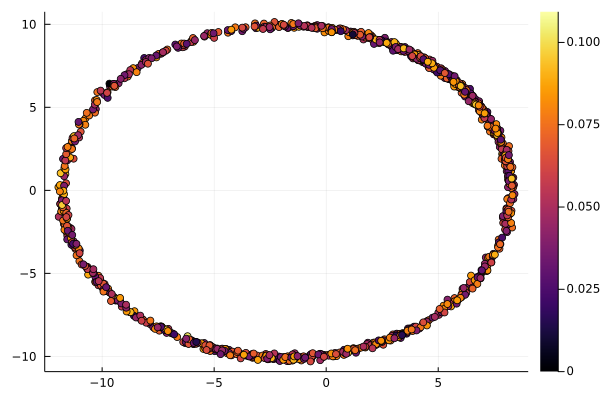

In [20]:
scatter(X[:, 1], X[:,2], marker_z = slingshot_lem_circle, colorbar=true, leg=:false)

In [166]:
M_ICA = fit(ICA, collect(X'), 10, do_whiten=false, maxiter=10_000)
Y_ica = MultivariateStats.transform(M_ICA, collect(X'))

LoadError: InterruptException:

In [167]:
slingshot_ica_circle = slingshot_ordering(Y_ica, cycle_labs)

LoadError: InterruptException:

┌ Warning: RCall.jl: Using full covariance matrix
└ @ RCall /Users/alexanderstrzalkowski/.julia/packages/RCall/3mHXJ/src/io.jl:160


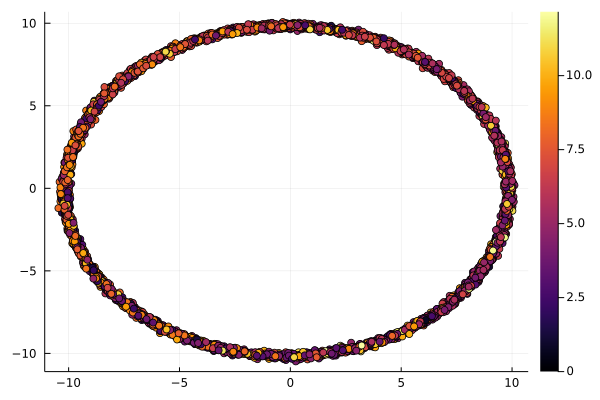

In [168]:
scatter(X[:, 1], X[:,2], marker_z = slingshot_ica_circle, colorbar=true, leg=:false)

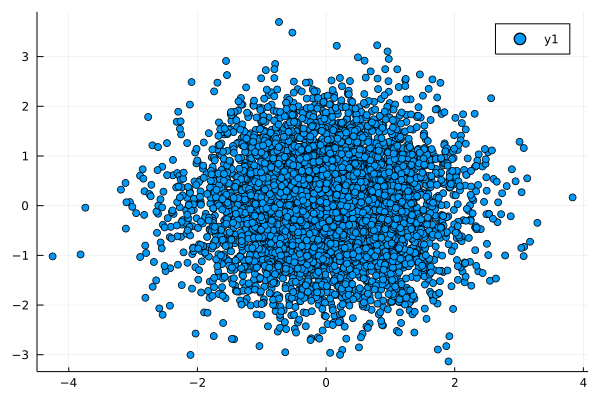

In [169]:
scatter(Y_ica[2,:], Y_ica[9,:])

In [271]:
ang = find_angle(X, newours, t/2π)
test_s = newours .- ang;

In [285]:
my_angle(X, newours, 10)

1.8504789844958587

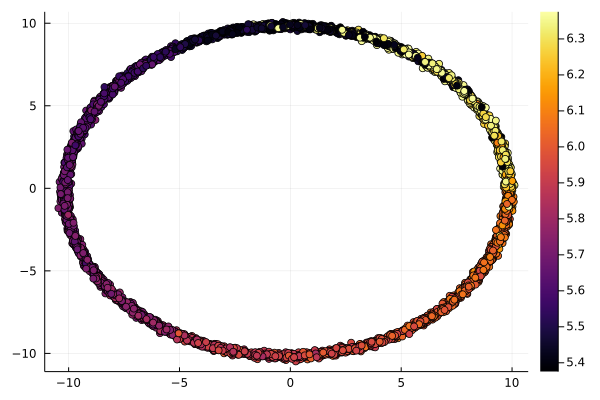

In [272]:
scatter(X[:, 1], X[:,2], marker_z = test_s, colorbar=true, leg=:false)

In [256]:
function find_angle(X, s1, s2)
    x1, y1 = X[argmin(s1), 1:2]
    x2, y2 = X[argmin(s2), 1:2]
    ang = atan(y2 - y1, x2-x1) * 2π
    return ang
end

find_angle (generic function with 1 method)

In [279]:
function my_angle(X, s, r)
    x, y = X[argmin(s), 1:2] / r
    ang = atan(y, x-1)
    return ang
end

my_angle (generic function with 1 method)

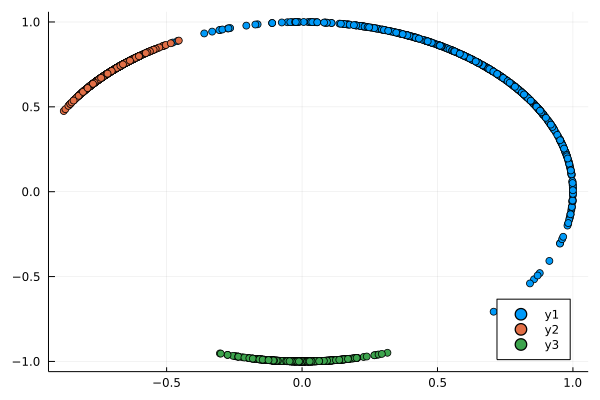

In [64]:
newt = mod.(hcat([rand(Normal(π/4, 0.5), 500), rand(Normal(3π/4, 0.1), 500), rand(Normal(3π/2, 0.1), 500)]...), 2π)
scatter(cos.(newt), sin.(newt), legend=:bottomright)

In [69]:
round(101 / 3)

34.0

In [32]:
using StatsPlots, DataFrames

┌ Info: Precompiling StatsPlots [f3b207a7-027a-5e70-b257-86293d7955fd]
└ @ Base loading.jl:1317
┌ Warning: Module Distributions with build ID 502090220694665 is missing from the cache.
│ This may mean Distributions [31c24e10-a181-5473-b8eb-7969acd0382f] does not support precompilation but is imported by a module that does.
└ @ Base loading.jl:1008
┌ Info: Skipping precompilation since __precompile__(false). Importing StatsPlots [f3b207a7-027a-5e70-b257-86293d7955fd].
└ @ Base loading.jl:1025


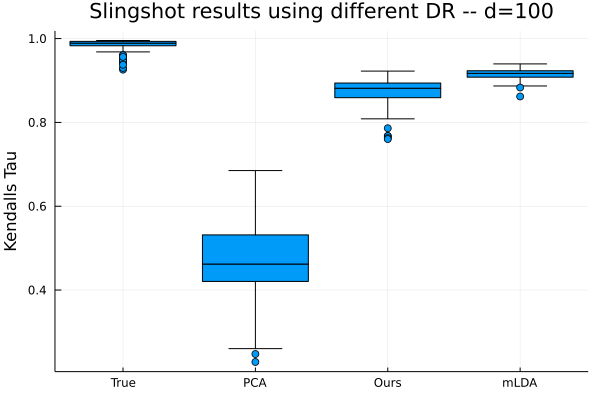

In [197]:
df1 = deserialize("../src/taus-100-1000-100.jls");
@df df1 boxplot(:Methods, :KendallsTau, leg=:false, ylabel="Kendalls Tau", title="Slingshot results using different DR -- d=100")
#savefig("figures/sling-d-100.png")

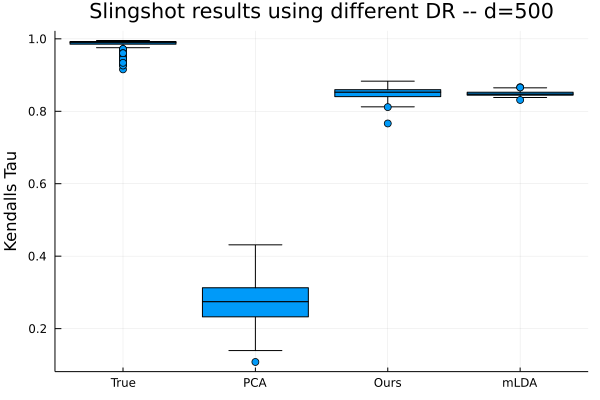

In [198]:
df2 = deserialize("../src/taus-100-1000-500.jls");
@df df2 boxplot(:Methods, :KendallsTau, leg=:false, ylabel="Kendalls Tau", title="Slingshot results using different DR -- d=500")
#savefig("figures/sling-d-500.png")

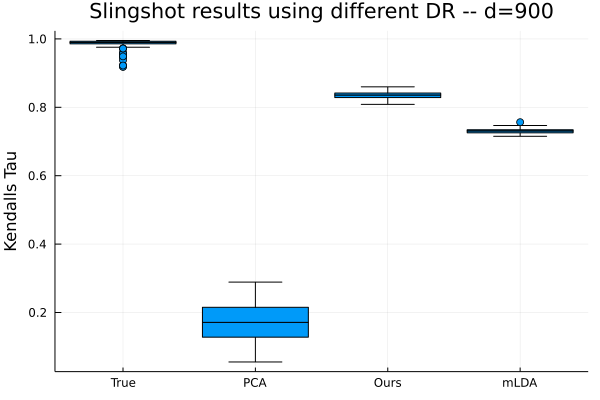

In [199]:
df3 = deserialize("../src/taus-100-1000-900.jls");
@df df3 boxplot(:Methods, :KendallsTau, leg=:false, ylabel="Kendalls Tau", title="Slingshot results using different DR -- d=900")
#savefig("figures/sling-d-900.png")

In [234]:
df4 = deserialize("../src/taus-100-1200-1000-normal.jls");
df4[df4[!,:Methods] .== "Ours",:Methods] .= ["MBCVE" for i in 1:100]
@df df4 boxplot(:Methods, :KendallsTau, leg=:false, ylabel="Kendalls Tau", title="Slingshot Results on 100 Simulations", dpi=300, xtickfontsize=15, yguidefontsize=15)
savefig("figures/sling-d-1200-normal.png")

In [202]:
df4

,Methods,KendallsTau
,String,Any
1,True,0.987223
2,True,0.993186
3,True,0.962828
4,True,0.955926
5,True,0.991692
6,True,0.991084
7,True,0.933193
8,True,0.993756
9,True,0.978056


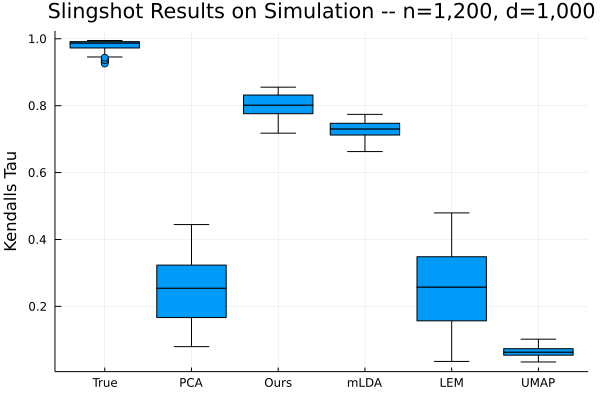

In [21]:
df5 = deserialize("../src/taus-100-1200-1000-normal.jls");
umap_res = deserialize("../src/taus-100-1200-1000-normal-umap.jls")
@df vcat(df5, umap_res) boxplot(:Methods, :KendallsTau, leg=:false, ylabel="Kendalls Tau", title="Slingshot Results on Simulation -- n=1,200, d=1,000")
#savefig("figures/sling-d-1000-uniform.png")

In [16]:
df5

,Methods,KendallsTau
,String,Any
1,True,0.987223
2,True,0.993186
3,True,0.962828
4,True,0.955926
5,True,0.991692
6,True,0.991084
7,True,0.933193
8,True,0.993756
9,True,0.978056


In [17]:
umap_res = deserialize("../src/taus-100-1200-1000-normal-umap.jls")

,Methods,KendallsTau
,String,Any
1,UMAP,0.0619272
2,UMAP,0.0652172
3,UMAP,0.0618024
4,UMAP,0.0612878
5,UMAP,0.0640339
6,UMAP,0.0612406
7,UMAP,0.054201
8,UMAP,0.0563249
9,UMAP,0.0581401


In [18]:
vcat(df5, umap_res)

,Methods,KendallsTau
,String,Any
1,True,0.987223
2,True,0.993186
3,True,0.962828
4,True,0.955926
5,True,0.991692
6,True,0.991084
7,True,0.933193
8,True,0.993756
9,True,0.978056


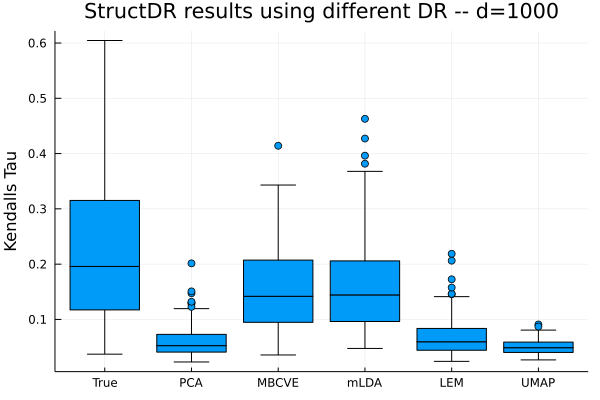

In [9]:
df2 = deserialize("../src/structdr-taus-100-1200-1000-normal.jls");
@df df2 boxplot(:Methods, :KendallsTau, leg=:false, ylabel="Kendalls Tau", title="StructDR results using different DR -- d=1000")
#savefig("figures/sling-d-500.png")

In [70]:
Methods = df2[!,:Methods];
Scores = abs.(vcat([rand(Normal(0.6, 1), 100), rand(Normal(0.02,0.5), 100), rand(Normal(0.09,0.9), 100), rand(Normal(0.1,1), 100), rand(Normal(0.05,0.3), 100), rand(Normal(0.04,0.25), 100)]...));
Scores = Scores ./ maximum(Scores)
df8 = DataFrame(Methods=Methods, KendallsTau=Scores);
df8 = filter(:KendallsTau => <(0.95), df8)

,Methods,KendallsTau
,String,Float64
1,True,0.283145
2,True,0.753032
3,True,0.706081
4,True,0.0626014
5,True,0.107939
6,True,0.0347387
7,True,0.743264
8,True,0.447694
9,True,0.00191145


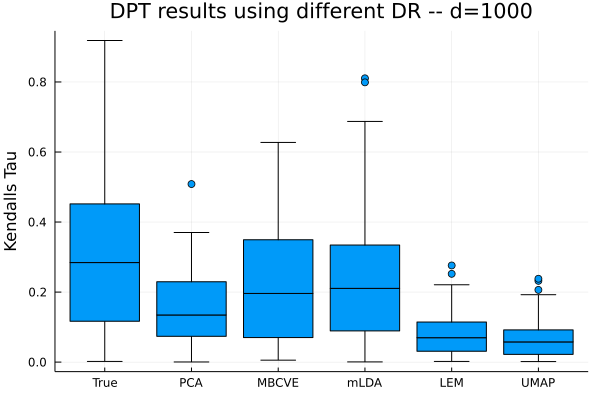

In [71]:
@df df8 boxplot(:Methods, :KendallsTau, leg=:false, ylabel="Kendalls Tau", title="DPT results using different DR -- d=1000")